In [1]:
# Before running this notebook, you need to set the following variables in structs.jl for mutable struct Args: 
#   data_string: "data_scenario1"
#   pre_transformation: true

In [1]:
cd("../.") 
pwd()

"/Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups"

In [2]:
using Pkg
if isfile("Project.toml") && isfile("Manifest.toml")
    Pkg.activate(".")
end

# Pkg.instantiate()
using IJulia

using Revise



  Activating environment at `~/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/Project.toml`


In [3]:
includet("../AIQN/AIQN.jl")
includet("../src/structs.jl")
includet("../src/report.jl")
includet("../src/transformations.jl")
includet("../src/VAE.jl")
includet("../src/load_data.jl")
includet("../src/evaluation/evaluation.jl")
includet("../src/classification.jl")
includet("../src/GLM.jl")

# Set default DPI to 300
default(dpi=300)


In [30]:

x, dataTypeArray,args = load_dataset()

if args.data_string == "data_scenario1"
    args.pre_transformation = true
    args.scaling_method= "standardization"

else
    println("For this notebook you should set the args.data_string = data_scenario1")

    println("change the struct and restart the notebook again")
end

"standardization"

In [31]:
Random.seed!(11)
preprocess_ps = preprocess_params(input_dim = args.input_dim)
preprocessed_data, preprocess_ps = preprocess!(args, preprocess_ps, x, dataTypeArray)

Estimation of Box-Cox transformation parameters:

 λ1 estimation for feature 1:
λ1 estimation for feature 1 is converged at epoch 19!


 λ1 estimation for feature 2:

 λ1 estimation for feature 3:
Epoch 100: loss = 5508.472135087825
Epoch 200: loss = 5457.575754512804
Epoch 300: loss = 5416.21866771814
Epoch 400: loss = 5382.288661509288
Epoch 500: loss = 5354.623583718057
Epoch 600: loss = 5332.314114127253
Epoch 700: loss = 5314.570311446534
Epoch 800: loss = 5300.68224812172
Epoch 900: loss = 5290.006137685859
Epoch 1000: loss = 5281.961602183264
Epoch 1100: loss = 5276.032924667839
Epoch 1200: loss = 5271.766486161824
Epoch 1300: loss = 5268.7756057190045
Epoch 1400: loss = 5266.736777894661
Epoch 1500: loss = 5265.3875575622005
Epoch 1600: loss = 5264.522804303886
Epoch 1700: loss = 5263.986783674713
Epoch 1800: loss = 5263.66590602017
Epoch 1900: loss = 5263.48103307921
Epoch 2000: loss = 5263.378606472207
Epoch 2100: loss = 5263.32410181916
λ1 estimation for feature 3 is converg

┌ Info: Saved animation to /Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/runs/run_464/pre_transformation/power_transformation/animations/anim_1.gif
└ @ Plots /Users/farhadyar/.julia/packages/Plots/aRJ6C/src/animation.jl:149
┌ Info: Saved animation to /Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/runs/run_464/pre_transformation/power_transformation/animations/anim_2.gif
└ @ Plots /Users/farhadyar/.julia/packages/Plots/aRJ6C/src/animation.jl:149
┌ Info: Saved animation to /Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/runs/run_464/pre_transformation/power_transformation/animations/anim_3.gif
└ @ Plots /Users/farhadyar/.julia/packages/Plots/aRJ6C/src/animation.jl:149
┌ Info: Saved animation to /Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/runs/run_464/pre_transformation/power_transformation/animations/anim_4.gif
└ @ Plots /Users/farhadyar/.julia/packages/Plots/aRJ6C/src/anima

([0.10406960605647265 0.35325639292501765 … -0.8876458335173452 -0.3923878787834532; 1.0 0.0 … 1.0 1.0; … ; 1.0 1.0 … 1.0 1.0; 1.0 0.0 … 0.0 1.0], preprocess_params
  input_dim: Int64 18
  pre_transformation_type: String "power"
  qt_array: Array{QuantileTransformer}((0,))
  n_quantiles: Int64 100
  λ2: Array{Float32}((18,)) Float32[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.01, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
  λ1: Array{Float32}((18,)) Float32[1.0215019, 1.0, 0.012822714, 1.0, 1.0, -0.21524265, 0.22842361, 1.0, 1.0, 1.0, 0.43822208, 0.96930677, 0.93299437, 0.88316303, 1.0, 1.0, 1.0, 1.0]
  box_cox_epochs: Int64 5000
  box_cox_η: Float32 0.001f0
  μ: Array{Float32}((18,)) Float32[0.16600335, 0.0, 3.0950694, 0.0, 0.0, 1.4310942, 0.09005379, 0.0, 0.0, 0.0, -1.5648547, -0.79664546, -0.23504998, 0.940734, 0.0, 0.0, 0.0, 0.0]
  σ: Array{Float32}((18,)) Float32[4.2327538, 0.5, 0.41073892, 0.5, 0.5, 0.2760269, 0.8146019, 0.5, 0.5, 0.5, 0.45912346, 3.3012729, 0.83783597, 3.2927036

In [32]:

args.η = 0.0001f0
args.λ = 0.01f0
args.β = 0.1
args.batch_size = 128
args.epochs = 1500
args.seed = 42
args.input_dim = 18
args.latent_dim = 2
args.hidden_dim = 21
args.latent_fusion_method = false     
args.multimodal_encoder = true
args.IPW_sampling = false
args.grid_point_size = 0.1



if args.hyperopt_flag
    trainVAE_hyperparams_opt!(preprocessed_data, x, dataTypeArray, preprocess_ps, args)
else
    model, training_data, loss_array_vae = trainVAE!(preprocessed_data, x, dataTypeArray, preprocess_ps, args)
end


Epoch 100: loss = 11.405599221871379
Epoch 200: loss = 10.227649666820856
Epoch 300: loss = 9.409426609901548
Epoch 400: loss = 8.931120852261804
Epoch 500: loss = 8.365121320284526
Epoch 600: loss = 7.504048306659356
Epoch 700: loss = 6.551697700552724
Epoch 800: loss = 6.034568665712618
Epoch 900: loss = 5.594475679547204
Epoch 1000: loss = 5.226213666194819
Epoch 1100: loss = 4.928601998546182
Epoch 1200: loss = 4.646964723962827
Epoch 1300: loss = 4.380243553923792
Epoch 1400: loss = 4.187160510443563
Epoch 1500: loss = 3.985511043616519


(multimodal_vae(Dense(10 => 10, tanh), Dense(8 => 8, tanh), Dense(10 => 2), Dense(8 => 2), Dense(10 => 2), Dense(8 => 2), Dense(2 => 21, tanh), Dense(21 => 8), Dense(21 => 8), Dense(21 => 10, σ), Bool[1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0], 8, 10, false, 0.1, TBLogger("/Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/runs/run_464/vae"), min_level=Info, purge_step=1500)), DataLoader{Adjoint{Float64, Matrix{Float64}}, Random._GLOBAL_RNG, Val{nothing}}([0.10406960605647265 0.35325639292501765 … -0.8876458335173452 -0.3923878787834532; 1.0 0.0 … 1.0 1.0; … ; 1.0 1.0 … 1.0 1.0; 1.0 0.0 … 0.0 1.0], 128, false, true, true, false, Val{nothing}(), Random._GLOBAL_RNG()), Any[17.266795719509503, 17.22321791187399, 16.96248415388155, 16.800313934987678, 16.69274606428903, 16.506779780313433, 16.39042368244627, 16.355127349262418, 16.27753742896686, 16.093304801621812  …  4.0172630071820805, 3.9922481202440117, 4.001805677718572, 4.026208658585647, 3.9904449

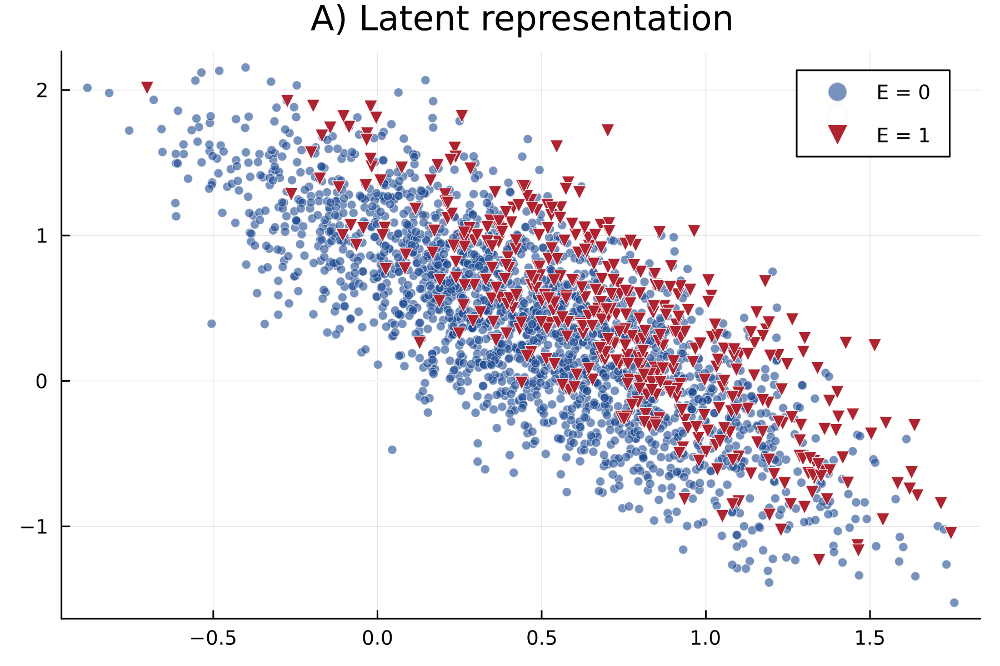

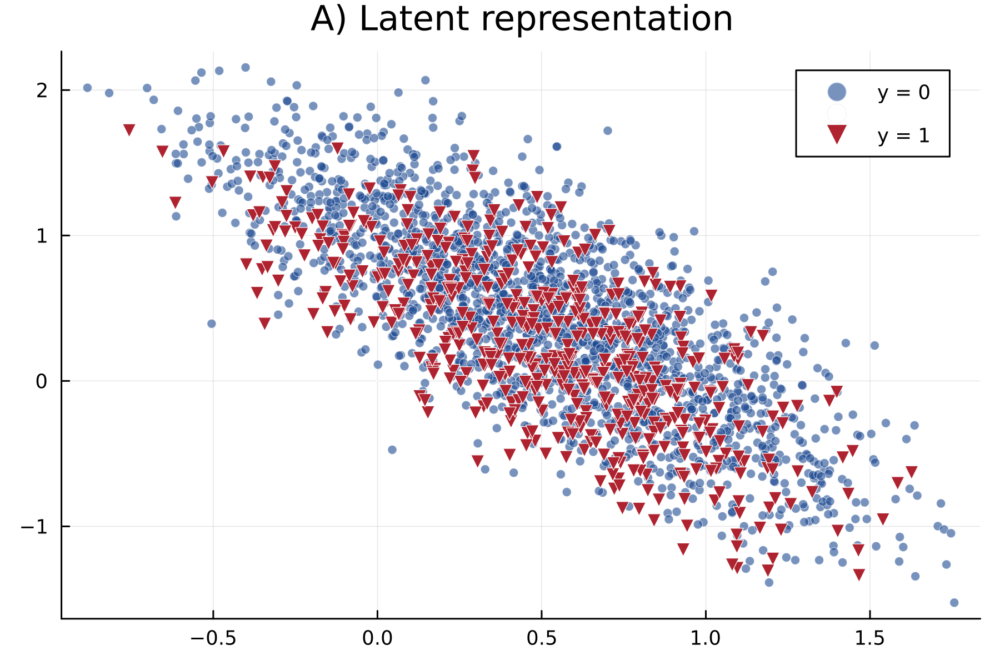

In [33]:
z = get_latent(preprocessed_data, model, args, preprocess_ps)
E = load_exposure(args.data_string)
y = load_outcome(args.data_string)
E_O = Int.(E) .& Int.(y)

display(scatter_latent(z, "E", E,  "A) Latent representation"))
Plots.savefig("figures/known_subgroups_only_latent_E.png")
Plots.savefig("figures/known_subgroups_only_latent_E.pdf")

scatter_latent(z, "y", y, "A) Latent representation")

In [34]:
data_glm = x
x6_inclusion = false


type_vector = [length(unique(data_glm[:, col])) > 2 for col in 1:size(data_glm, 2)]
x_μ = vec(mean(data_glm, dims=1)) .* type_vector
x_σ = (vec(std(data_glm, dims=1)) .* type_vector) .+ (0.5 * .!type_vector)
data_glm = standardize(x_μ, x_σ, data_glm)'



training_glm = hcat(data_glm, E, y)


includet("../src/GLM.jl")


exposure_model, selected_features_exposure = fit_logistic_regression_exposure(training_glm, x6_inclusion)

outcome_model, selected_features_outcome = fit_logistic_regression_outcome(training_glm, x6_inclusion)

e_o_model_and, selected_features_e_o_and= fit_logistic_regression_selected_features_both(training_glm,selected_features_exposure, selected_features_outcome, x6_inclusion)


e_o_model_or, selected_features_e_o_or = fit_logistic_regression_selected_features_either(training_glm,selected_features_exposure, selected_features_outcome, x6_inclusion)

model = StatsModels.TableRegressionModel{GeneralizedLinearModel{GLM.GlmResp{Vector{Float64}, Binomial{Float64}, LogitLink}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

y ~ 1 + x1 + x2 + x3 + x4a + x4b + x5 + x7 + x8 + x9a + x9b + x10 + x11 + x12 + x13 + x15 + x16 + x17 + x18

Coefficients:
───────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error      z  Pr(>|z|)   Lower 95%  Upper 95%
───────────────────────────────────────────────────────────────────────────
(Intercept)  -0.877306    0.199805   -4.39    <1e-04  -1.26892    -0.485695
x1           -0.416194    0.134563   -3.09    0.0020  -0.679931   -0.152456
x2           -0.0711121   0.147832   -0.48    0.6305  -0.360858    0.218634
x3            0.486842    0.113844    4.28    <1e-04   0.263711    0.709973
x4a          -0.775594    0.145303   -5.34    <1e-07  -1.06038    -0.490804
x4b           0.054549    0.12994     0.42    0.6746  -

(StatsModels.TableRegressionModel{GeneralizedLinearModel{GLM.GlmResp{Vector{Float64}, Binomial{Float64}, LogitLink}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Exposure ~ 1 + x4a + x5 + x16 + x9b + x17 + x3 + x9a + x18 + x8 + x7 + x1 + x11 + x10

Coefficients:
───────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error       z  Pr(>|z|)  Lower 95%  Upper 95%
───────────────────────────────────────────────────────────────────────────
(Intercept)  -3.58047      0.265972  -13.46    <1e-40  -4.10176   -3.05917
x4a          -0.182566     0.201156   -0.91    0.3641  -0.576825   0.211693
x5           -0.0248028    0.132592   -0.19    0.8516  -0.284679   0.235073
x16           0.888696     0.14993     5.93    <1e-08   0.594838   1.18255
x9b           0.740598     0.261155    2.84    0.0046   0.228744   1.25245
x17           0.813685     0.199048    4.09    <1e-04   0.423559   1.20381
x3          

In [35]:
@show selected_features_exposure
@show selected_features_outcome
@show selected_features_e_o_and
@show selected_features_e_o_or

println("")

selected_features_exposure = Set(["x8", "x7", "x16", "x9b", "x11", "x17", "x18"])
selected_features_outcome = Set(["x4a", "x5", "x1", "x7", "x11", "x10", "x3", "x9a"])
selected_features_e_o_and = ["x7", "x11"]
selected_features_e_o_or = ["x4a", "x5", "x16", "x9b", "x17", "x3", "x9a", "x18", "x8", "x7", "x1", "x11", "x10"]



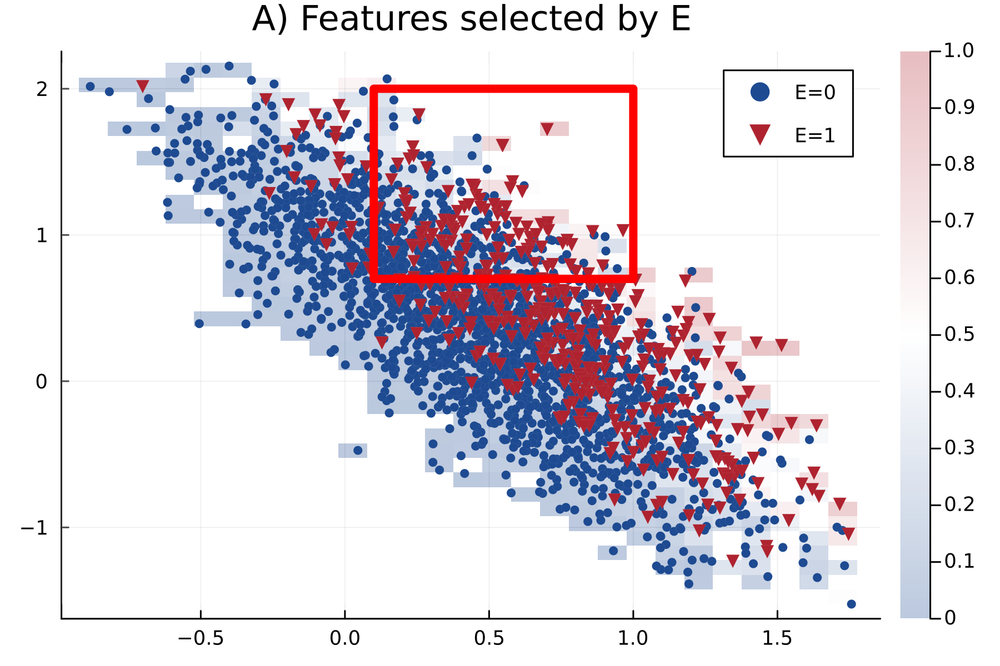

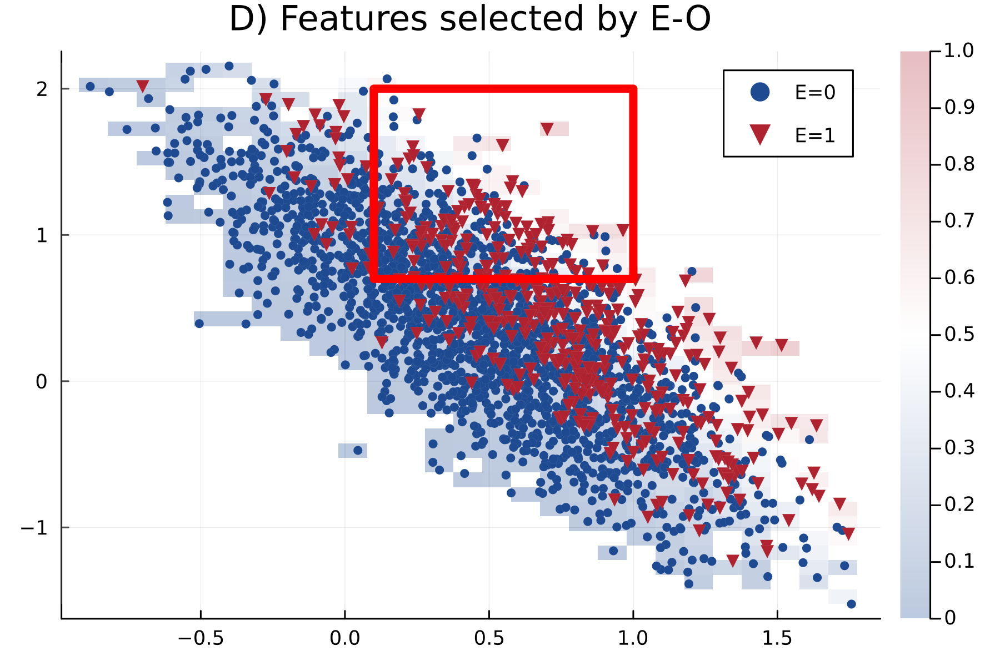

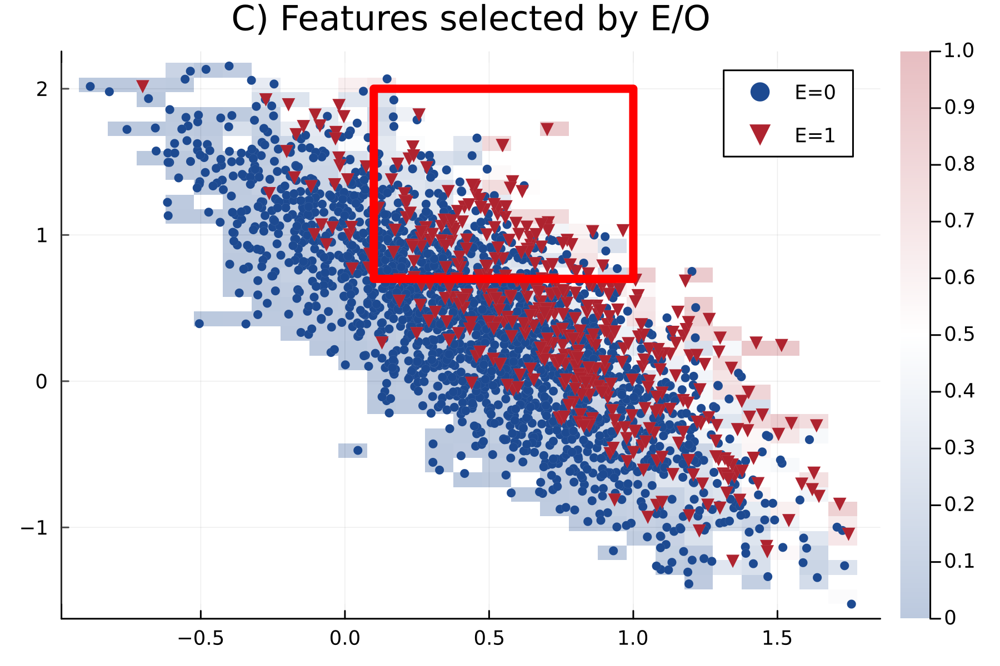

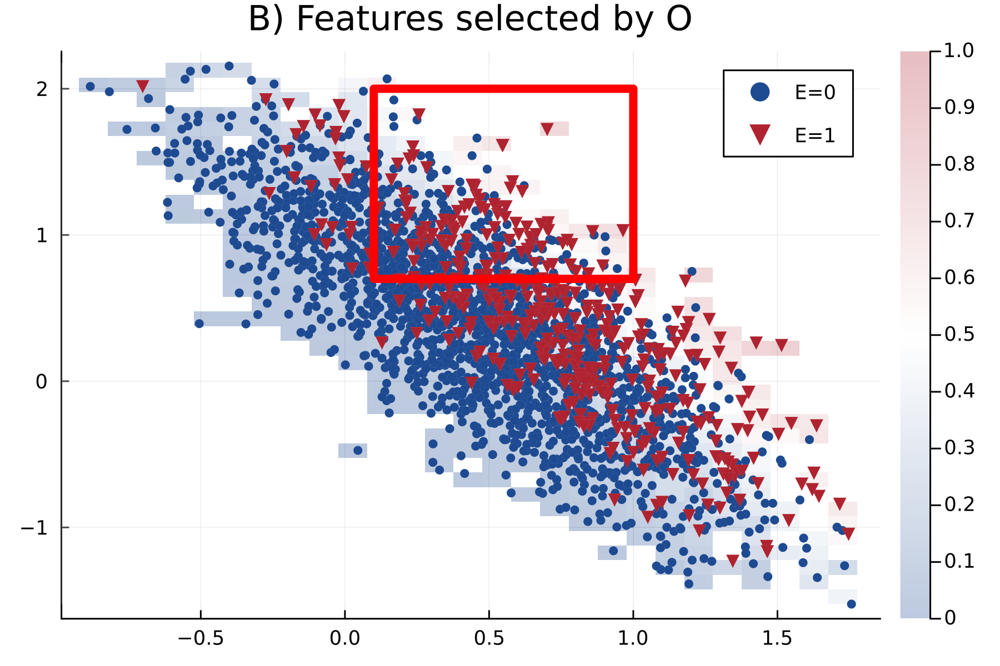

In [36]:
includet("../visualization/visualization.jl")
Random.seed!(42)

probabilities_e = predict_probability(exposure_model, training_glm, x6_inclusion)

probabilities_o = predict_probability(outcome_model, training_glm, x6_inclusion)

probabilities_e_o_and = predict_probability(e_o_model_and, training_glm,  x6_inclusion)

probabilities_e_o_or = predict_probability(e_o_model_or, training_glm,  x6_inclusion)


size(700,500)

# Get the rectangle coordinates
rect_coords = rectangle_from_coords(0.1, 0.7, 1, 2)

# Separate the coordinates into x and y arrays
x_rect = rect_coords[:, 1]
y_rect = rect_coords[:, 2]


# Get the rectangle coordinates
rect_coords2 = rectangle_from_coords(1.45, -1.3, 1.6, -1)

# Separate the coordinates into x and y arrays
x_rect2 = rect_coords2[:, 1]
y_rect2= rect_coords2[:, 2]


plt = latent_propensity_ovrlay(z, probabilities_e, 2500, E, y, "A) Features selected by E", true, args.grid_point_size)

# Plot the rectangle
plt = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false)
# plt = Plots.plot!(x_rect2, y_rect2, seriestype=:shape, fillalpha=0, color=:green, linecolor = :green, lw = 5, label=false)
display(plt)



plt2 = latent_propensity_ovrlay(z, probabilities_e_o_and, 2500, E, y, "D) Features selected by E-O", true, args.grid_point_size)
plt2 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false)

display(plt2)

plt3 = latent_propensity_ovrlay(z, probabilities_e_o_or, 2500, E, y, "C) Features selected by E/O", true, args.grid_point_size)
plt3 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false)
# plt3 = Plots.plot!(x_rect2, y_rect2, seriestype=:shape, fillalpha=0, color=:green, linecolor = :green, lw = 5, label=false)
display(plt3)



plt4 = latent_propensity_ovrlay(z, probabilities_o, 2500, E, y, "B) Features selected by O", true, args.grid_point_size)
plt4 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false)
display(plt4)


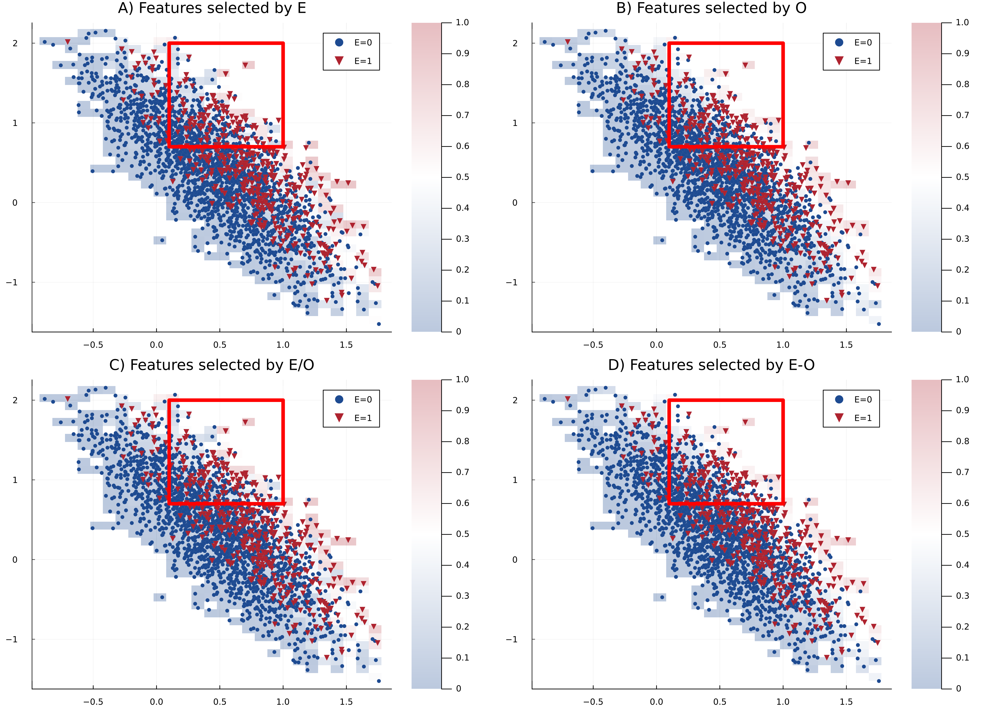

In [37]:
# figure4 = Plots.plot(plt, plt2, layout = (1, 2), size = (1400, 500))
figure4 = Plots.plot(plt, plt4, plt3, plt2, layout = (2, 2), size = (1400, 1000))

In [38]:
Plots.savefig(figure4, "./figures/Figure4_exposure_outcome_4plots.png")
Plots.savefig(figure4, "./figures/Figure4_exposure_outcome_4plots.pdf")

"/Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/figures/Figure4_exposure_outcome_4plots.pdf"

In [39]:
# Set the input and output filenames
input_pdf =  "./figures/Figure4_exposure_outcome_4plots.pdf"
output_eps =  "./figures/Figure4_exposure_outcome_4plots.eps"

# Construct the Ghostscript command
command = `gs -dNOPAUSE -dBATCH -dEPSCrop -r300 -sDEVICE=eps2write -sOutputFile=$output_eps $input_pdf`

# Run the command
run(command)

GPL Ghostscript 10.01.2 (2023-06-21)
Copyright (C) 2023 Artifex Software, Inc.  All rights reserved.
This software is supplied under the GNU AGPLv3 and comes with NO WARRANTY:
see the file COPYING for details.
Processing pages 1 through 1.
Page 1


Process(`gs -dNOPAUSE -dBATCH -dEPSCrop -r300 -sDEVICE=eps2write -sOutputFile=./figures/Figure4_exposure_outcome_4plots.eps ./figures/Figure4_exposure_outcome_4plots.pdf`, ProcessExited(0))

## Both lables

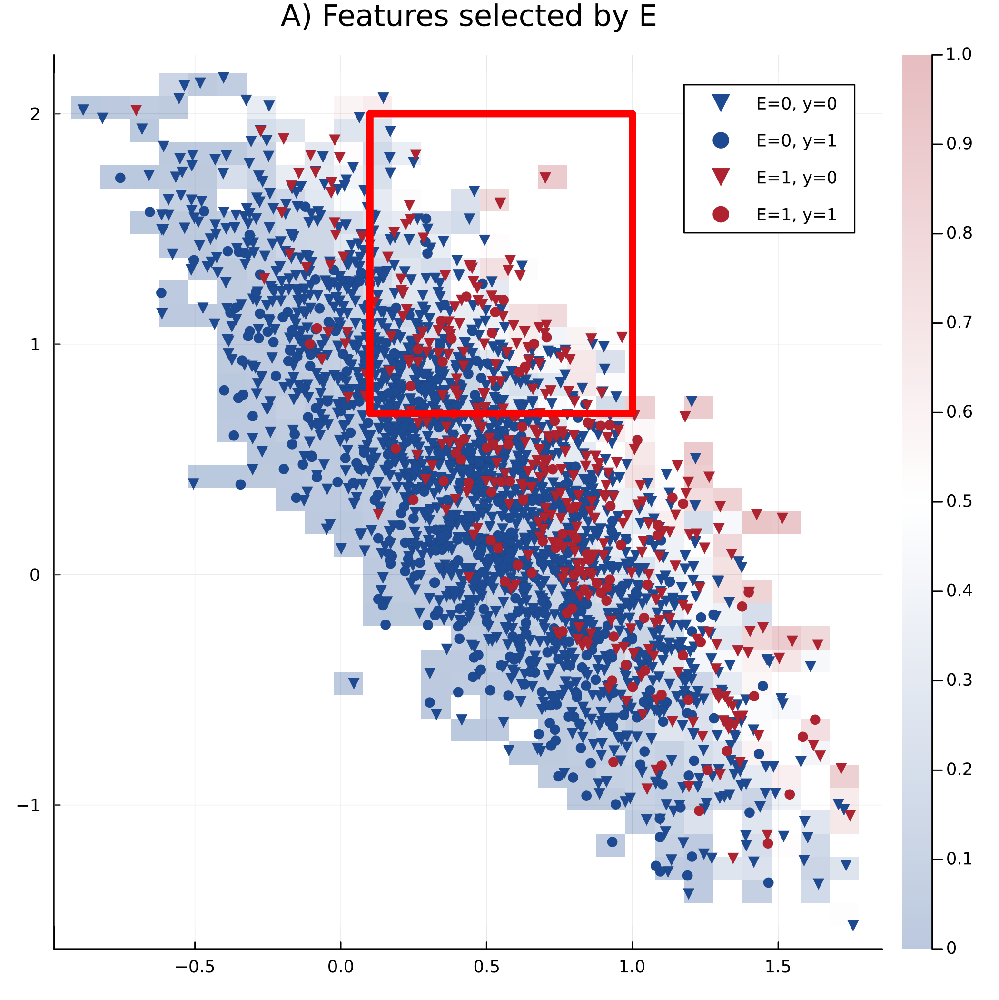

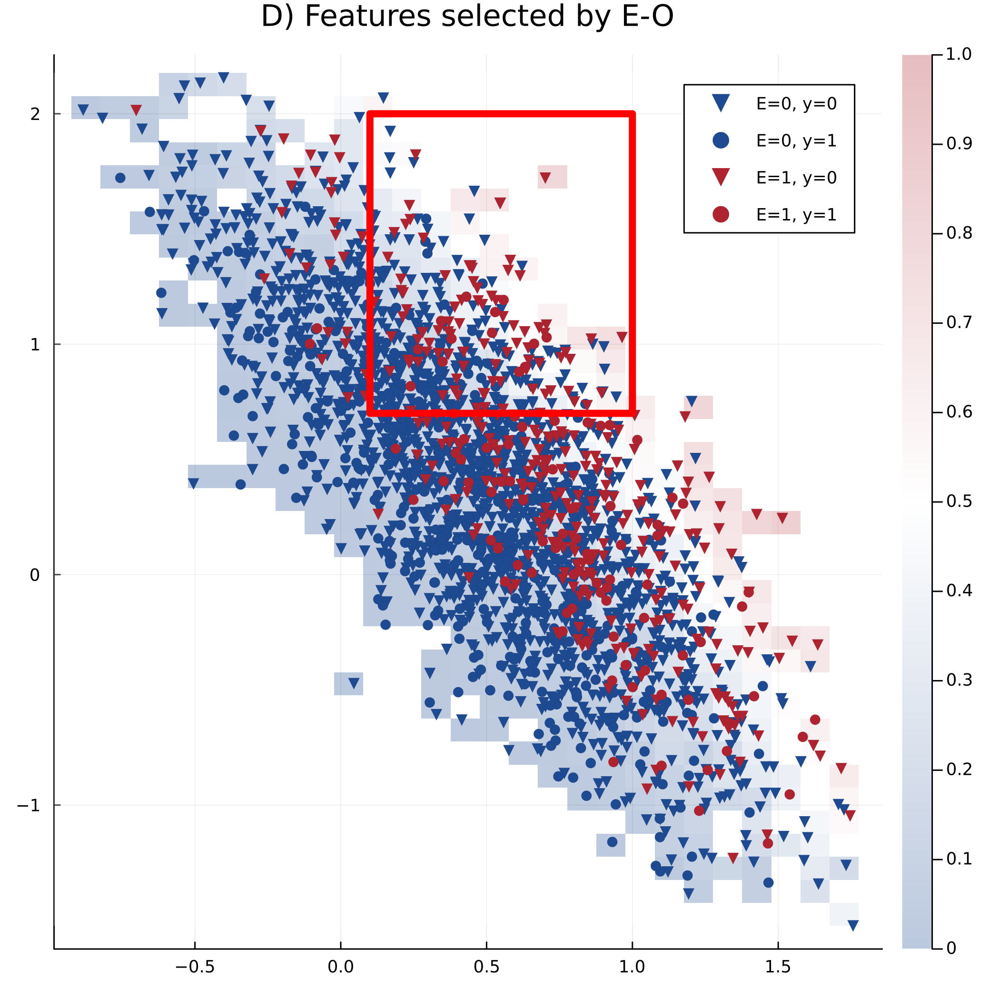

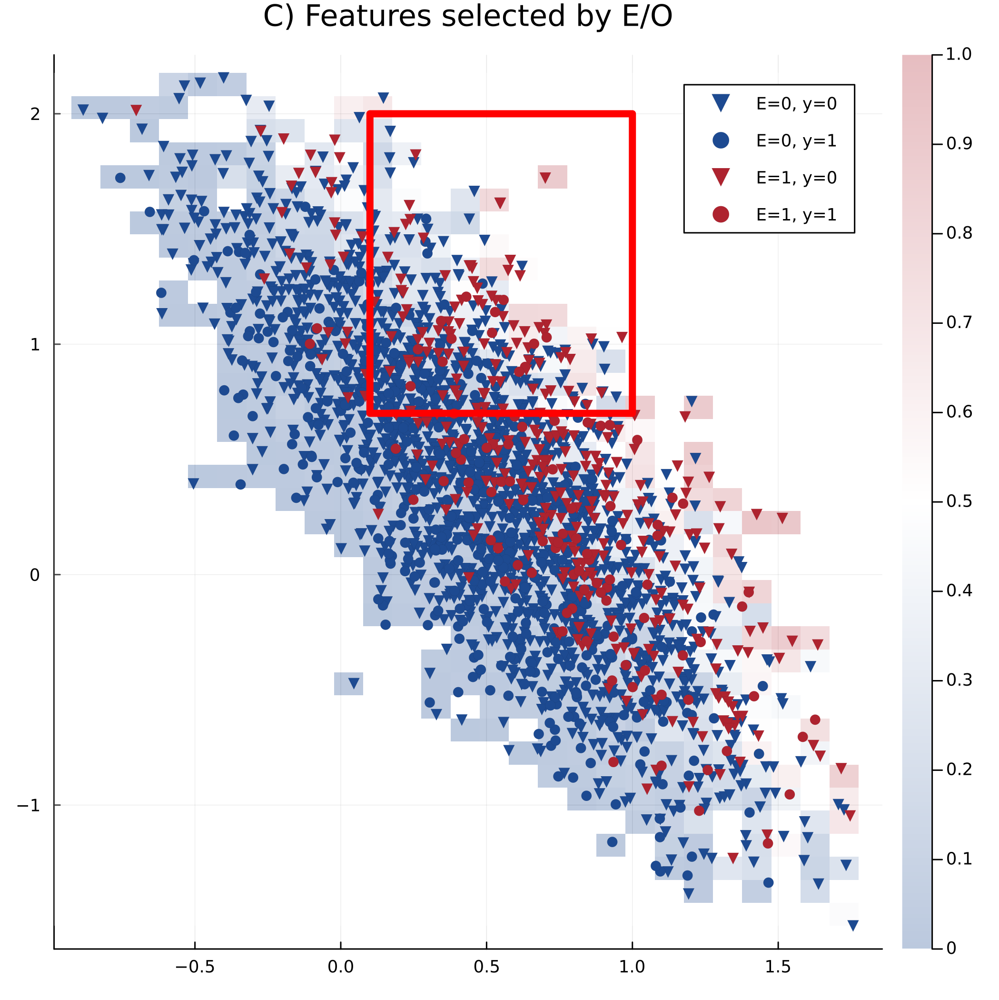

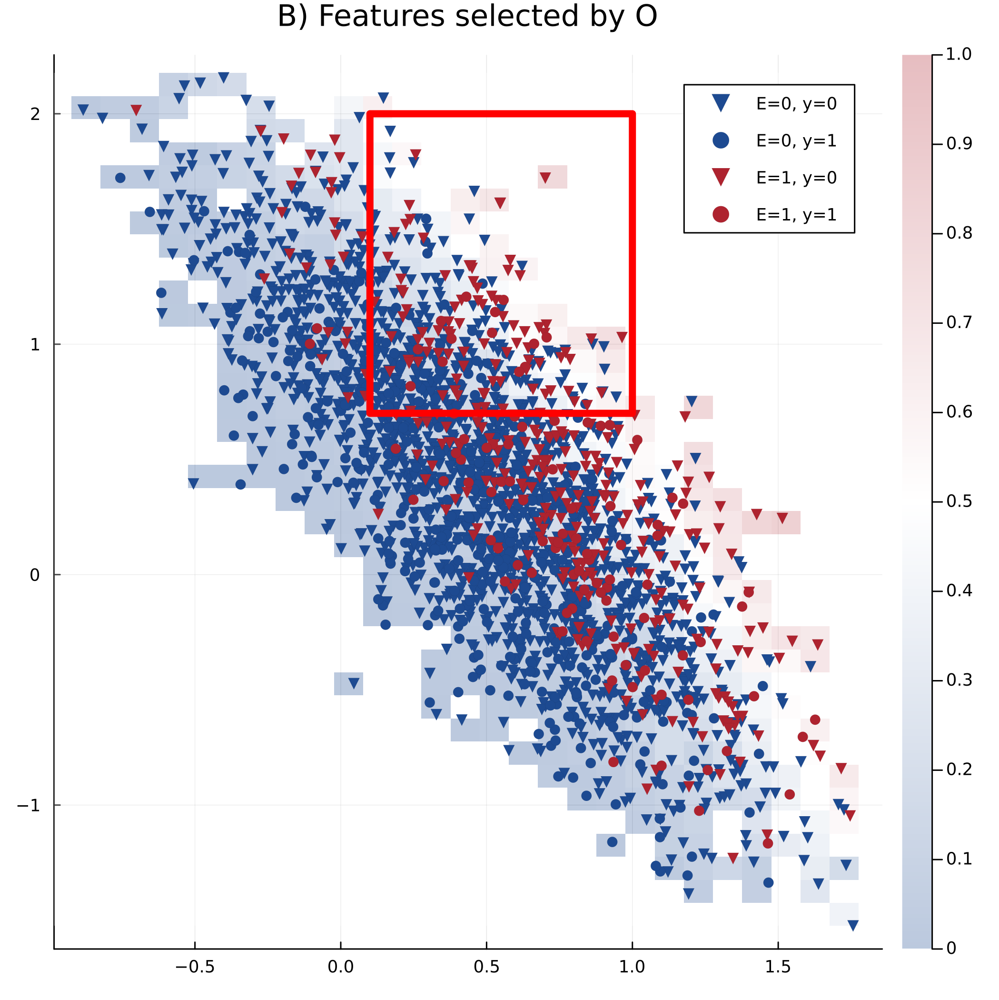

In [84]:
includet("../visualization/visualization.jl")
Random.seed!(42)

probabilities_e = predict_probability(exposure_model, training_glm, x6_inclusion)

probabilities_o = predict_probability(outcome_model, training_glm, x6_inclusion)

probabilities_e_o_and = predict_probability(e_o_model_and, training_glm,  x6_inclusion)

probabilities_e_o_or = predict_probability(e_o_model_or, training_glm,  x6_inclusion)


size(700,500)

# Get the rectangle coordinates
rect_coords = rectangle_from_coords(0.1, 0.7, 1, 2)

# Separate the coordinates into x and y arrays
x_rect = rect_coords[:, 1]
y_rect = rect_coords[:, 2]


# Get the rectangle coordinates
rect_coords2 = rectangle_from_coords(1.45, -1.3, 1.6, -1)

# Separate the coordinates into x and y arrays
x_rect2 = rect_coords2[:, 1]
y_rect2= rect_coords2[:, 2]


plt = latent_propensity_ovrlay(z, probabilities_e, 2500, E, y, "A) Features selected by E", true, args.grid_point_size, "both")

# Plot the rectangle
plt = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false, size = (700,700) ) 
# plt = Plots.plot!(x_rect2, y_rect2, seriestype=:shape, fillalpha=0, color=:green, linecolor = :green, lw = 5, label=false)
display(plt)




plt2 = latent_propensity_ovrlay(z, probabilities_e_o_and, 2500, E, y, "D) Features selected by E-O", true, args.grid_point_size, "both")
plt2 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false, size = (700,700) )

display(plt2)

plt3 = latent_propensity_ovrlay(z, probabilities_e_o_or, 2500, E, y, "C) Features selected by E/O", true, args.grid_point_size, "both")
plt3 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false, size = (700,700) )
# plt3 = Plots.plot!(x_rect2, y_rect2, seriestype=:shape, fillalpha=0, color=:green, linecolor = :green, lw = 5, label=false)
display(plt3)



plt4 = latent_propensity_ovrlay(z, probabilities_o, 2500, E, y, "B) Features selected by O", true, args.grid_point_size, "both" )
plt4 = Plots.plot!(x_rect, y_rect, seriestype=:shape, fillalpha=0, color=:red, linecolor = :red, lw = 5, label=false, size = (700,700) )
display(plt4)


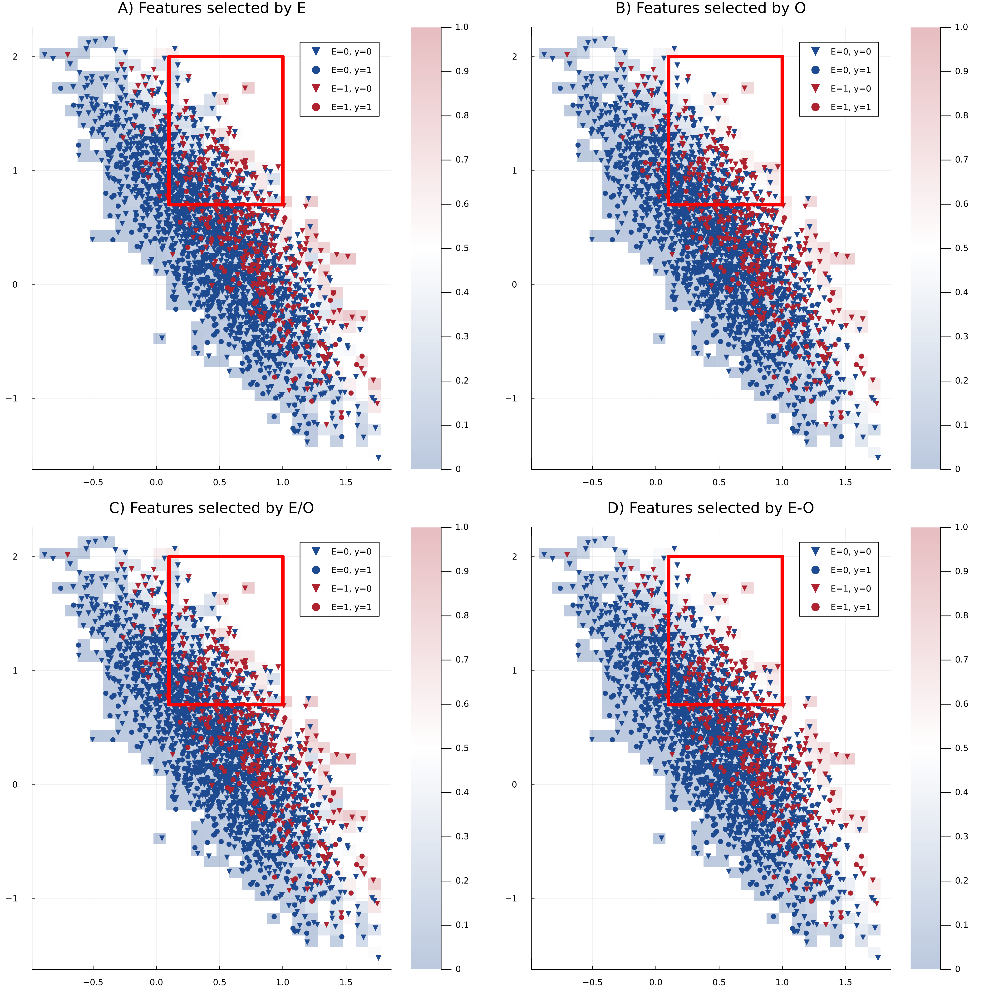

In [81]:
figure4 = Plots.plot(plt, plt4, plt3, plt2, layout = (2, 2), size = (1400, 1400))

In [85]:
Plots.savefig(figure4, "./figures/Figure4_exposure_outcome_4plots_both_lables.png")
Plots.savefig(figure4, "./figures/Figure4_exposure_outcome_4plots_both_lables.pdf")

"/Users/farhadyar/Documents/Project_PTVAE/progs/github_repo/LatentSubgroups/figures/Figure4_exposure_outcome_4plots_both_lables.pdf"

In [86]:
# Set the input and output filenames
input_pdf =  "./figures/Figure4_exposure_outcome_4plots_both_lables.pdf"
output_eps =  "./figures/Figure4_exposure_outcome_4plots_both_lables.eps"

# Construct the Ghostscript command
command = `gs -dNOPAUSE -dBATCH -dEPSCrop -r300 -sDEVICE=eps2write -sOutputFile=$output_eps $input_pdf`

# Run the command
run(command)

GPL Ghostscript 10.01.2 (2023-06-21)
Copyright (C) 2023 Artifex Software, Inc.  All rights reserved.
This software is supplied under the GNU AGPLv3 and comes with NO WARRANTY:
see the file COPYING for details.
Processing pages 1 through 1.
Page 1


Process(`gs -dNOPAUSE -dBATCH -dEPSCrop -r300 -sDEVICE=eps2write -sOutputFile=./figures/Figure4_exposure_outcome_4plots_both_lables.eps ./figures/Figure4_exposure_outcome_4plots_both_lables.pdf`, ProcessExited(0))